# Classificando Hidrometeoros
## Variáveis polarimétricas

Usando o pacote [CSU_RadarTools](https://github.com/CSU-RadarMet/CSU_RadarTools), as seguintes variáveis polarimétricas do radar da CTH foram utilizadas:  
`'corrected_reflectivity', 'cross_correlation_ratio', 'differential_reflectivity', 'specific_differential_phase'`

### Pacotes necessários

In [1]:
from __future__ import print_function
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import read_brazil_radar as rbr
import pyart
import glob
from skewt import SkewT
from csu_radartools import (csu_fhc, csu_liquid_ice_mass, csu_blended_rain, 
                            csu_dsd, csu_kdp, csu_misc, fundamentals)
%matplotlib inline


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



### `add_field_to_radar_object`: transformando array em dado de radar

In [2]:
def add_field_to_radar_object(field, radar, field_name='FH', units='unitless', 
                              long_name='Hydrometeor ID', standard_name='Hydrometeor ID',
                              dz_field='corrected_reflectivity'):
    """
    Adds a newly created field to the Py-ART radar object. If reflectivity is a masked array,
    make the new field masked the same as reflectivity.
    """
    fill_value = -32768
    masked_field = np.ma.asanyarray(field)
    masked_field.mask = masked_field == fill_value
    if hasattr(radar.fields[dz_field]['data'], 'mask'):
        setattr(masked_field, 'mask', 
                np.logical_or(masked_field.mask, radar.fields[dz_field]['data'].mask))
        fill_value = radar.fields[dz_field]['data'].fill_value
    field_dict = {'data': masked_field,
                  'units': units,
                  'long_name': long_name,
                  'standard_name': standard_name,
                  'fill_value': fill_value}
    radar.add_field(field_name, field_dict, replace_existing=True)
    return radar

### Funções que ajustam a escala de cores para a classificação

In [3]:
hid_colors = ['White', 'LightBlue', 'MediumBlue', 'DarkOrange', 'LightPink',
              'Cyan', 'DarkGray', 'Lime', 'Yellow', 'Red', 'Fuchsia']
cmaphid = colors.ListedColormap(hid_colors)
cmapmeth = colors.ListedColormap(hid_colors[0:6])
cmapmeth_trop = colors.ListedColormap(hid_colors[0:7])

def adjust_fhc_colorbar_for_pyart(cb):
    cb.set_ticks(np.arange(1.4, 10, 0.9))
    cb.ax.set_yticklabels(['Drizzle', 'Rain', 'Ice Crystals', 'Aggregates',
                           'Wet Snow', 'Vertical Ice', 'LD Graupel',
                           'HD Graupel', 'Hail', 'Big Drops'])
    cb.ax.set_ylabel('')
    cb.ax.tick_params(length=0)
    return cb

def adjust_meth_colorbar_for_pyart(cb, tropical=False):
    if not tropical:
        cb.set_ticks(np.arange(1.25, 5, 0.833))
        cb.ax.set_yticklabels(['R(Kdp, Zdr)', 'R(Kdp)', 'R(Z, Zdr)', 'R(Z)', 'R(Zrain)'])
    else:
        cb.set_ticks(np.arange(1.3, 6, 0.85))
        cb.ax.set_yticklabels(['R(Kdp, Zdr)', 'R(Kdp)', 'R(Z, Zdr)', 'R(Z_all)', 'R(Z_c)', 'R(Z_s)'])
    cb.ax.set_ylabel('')
    cb.ax.tick_params(length=0)
    return cb

### `radar_coords_to_cart`: Convertendo coordenadas do radar para cartesianas

In [4]:
def radar_coords_to_cart(rng, az, ele, debug=False):

    theta_e = ele * np.pi / 180.0  # elevation angle in radians.
    theta_a = az * np.pi / 180.0  # azimuth angle in radians.
    R = 6371.0 * 1000.0 * 4.0 / 3.0  # effective radius of earth in meters.
    r = rng * 1000.0  # distances to gates in meters.

    z = (r ** 2 + R ** 2 + 2.0 * r * R * np.sin(theta_e)) ** 0.5 - R
    s = R * np.arcsin(r * np.cos(theta_e) / (R + z))  # arc length in m.
    x = s * np.sin(theta_a)
    y = s * np.cos(theta_a)
    return x, y, z

### `get_z_from_radar`: Calculando altura do radar correspondente às elevações

In [5]:
def get_z_from_radar(radar):
    azimuth_1D = radar.azimuth['data']
    elevation_1D = radar.elevation['data']
    srange_1D = radar.range['data']
    sr_2d, az_2d = np.meshgrid(srange_1D, azimuth_1D)
    el_2d = np.meshgrid(srange_1D, elevation_1D)[1]
    xx, yy, zz = radar_coords_to_cart(sr_2d/1000.0, az_2d, el_2d)
    return zz + radar.altitude['data']

### `check_sounding_for_montonic`: Forçando os dados de sondagem a serem monotônicos

In [6]:
def check_sounding_for_montonic(sounding):
    snd_T = sounding.soundingdata['temp']  # In old SkewT, was sounding.data
    snd_z = sounding.soundingdata['hght']  # In old SkewT, was sounding.data
    dummy_z = []
    dummy_T = []
    if not snd_T.mask[0]: #May cause issue for specific soundings
        dummy_z.append(snd_z[0])
        dummy_T.append(snd_T[0])
        for i, height in enumerate(snd_z):
            if i > 0:
                if snd_z[i] > snd_z[i-1] and not snd_T.mask[i]:
                    dummy_z.append(snd_z[i])
                    dummy_T.append(snd_T[i])
        snd_z = np.array(dummy_z)
        snd_T = np.array(dummy_T)
    return snd_T, snd_z

### `interpolate_sounding_to_radar`: interpolando dados de radiossondagens aos de radar

In [7]:
def interpolate_sounding_to_radar(sounding, radar):
    radar_z = get_z_from_radar(radar)
    radar_T = None
    snd_T, snd_z = check_sounding_for_montonic(sounding)
    shape = np.shape(radar_z)
    rad_z1d = radar_z.ravel()
    rad_T1d = np.interp(rad_z1d, snd_z, snd_T)
    return np.reshape(rad_T1d, shape), radar_z

### `two_panel_plot`: Gera painel com dois gráficos com shapefile de São Paulo

In [8]:
def two_panel_plot(radar, coords_hpd, coords_sys, sweep=0, var1='reflectivity', vmin1=10, vmax1=70,
                   cmap1=None, units1='dBZ', var2='differential_reflectivity',
                   vmin2=-5, vmax2=5, cmap2='RdYlBu_r', units2='dB', return_flag=False,
                   xlim=[-47.5,-46.5], ylim=[-23.35,-22.5]):
    
    display = pyart.graph.RadarMapDisplay(radar)
    fig = plt.figure(figsize=(11,4))
   
    ax1 = fig.add_subplot(121)
    display.plot_ppi_map(var1, sweep=sweep, vmin=vmin1, vmax=vmax1, cmap=cmap1, shapefile="shapefiles/sao_paulo",
                         colorbar_label=units1, mask_outside=True, 
                         min_lat = ylim[0], max_lat = ylim[1], min_lon = xlim[0], max_lon = xlim[1], 
                         lat_lines=np.arange(ylim[0], ylim[1], .25), lon_lines=np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=coords_hpd[0], lon=coords_hpd[1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=coords_hpd[2], lon=coords_hpd[3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=coords_sys[0], lon=coords_sys[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')

    ax2 = fig.add_subplot(122)
    display.plot_ppi_map(var2, sweep=sweep, vmin=vmin2, vmax=vmax2, cmap=cmap2, shapefile="shapefiles/sao_paulo",
                         colorbar_label=units2, mask_outside=True,
                         min_lat = ylim[0], max_lat = ylim[1], min_lon = xlim[0], max_lon = xlim[1], 
                         lat_lines=np.arange(ylim[0], ylim[1], .25), lon_lines=np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=coords_hpd[0], lon=coords_hpd[1], symbol = 'ks', #-- Hailpad 1 
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=coords_hpd[2], lon=coords_hpd[3], symbol = 'ks', #-- Hailpad 2 
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=coords_sys[0], lon=coords_sys[1], symbol = 'k*', #-- Centro da caixa do sistema 
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    
    if return_flag:
        return fig, ax1, ax2, display

## Classificando por Fuzzy Logic

### Lendo dados de radiossondagens

In [9]:
snd_20161225 = SkewT.Sounding('../Dados/SONDAGENS/83779_2016120512Z.txt')
snd_20170131 = SkewT.Sounding('../Dados/SONDAGENS/83779_2017012812Z.txt')
snd_20170314 = SkewT.Sounding('../Dados/SONDAGENS/83779_2017031512Z.txt')
snd_20171115 = SkewT.Sounding('../Dados/SONDAGENS/83779_2017111512Z.txt')
snd_20171116 = SkewT.Sounding('../Dados/SONDAGENS/83779_2017111612Z.txt')

### Lista de arquivos de radar

#### CTH

In [10]:
files_cth_20161225 = open("dados_entrada/cth_level0_20161225", 'r')
files_cth_20161225 = files_cth_20161225.read().split('\n')

files_cth_20170131 = open("dados_entrada/cth_level0_20170131", 'r')
files_cth_20170131 = files_cth_20170131.read().split('\n')

files_cth_20170314 = open("dados_entrada/cth_level0_20170314", 'r')
files_cth_20170314 = files_cth_20170314.read().split('\n')

files_cth_20171115 = open("dados_entrada/cth_level0_20171115", 'r')
files_cth_20171115 = files_cth_20171115.read().split('\n')

files_cth_20171116 = open("dados_entrada/cth_level0_20171116", 'r')
files_cth_20171116 = files_cth_20171116.read().split('\n')

### Dados de rastreamento dos casos

In [11]:
#-- [item de files_cth, limites de lon, limites de lat]
caixas_20161225 = ([27, [-47.10, -47.04], [-22.97, -22.88]], [28, [-47.15, -47.02], [-23.00, -22.87]],
                   [29, [-47.15, -47.00], [-22.99, -22.86]], [30, [-47.15, -46.99], [-22.99, -22.84]],
                   [31, [-47.15, -46.99], [-22.99, -22.83]], [32, [-47.20, -46.98], [-22.98, -22.82]],
                   [33, [-47.20, -46.98], [-22.97, -22.81]], [34, [-47.17, -46.95], [-22.96, -22.81]],
                   [35, [-47.17, -46.95], [-22.95, -22.80]], [36, [-47.17, -46.94], [-23.02, -22.80]],
                   [37, [-47.17, -47.04], [-22.99, -22.84]], [38, [-47.19, -47.01], [-23.00, -22.81]],
                   [39, [-47.19, -46.99], [-23.00, -22.81]], [40, [-47.19, -46.98], [-23.00, -22.80]],
                   [41, [-47.19, -46.98], [-22.98, -22.78]], [42, [-47.19, -46.97], [-22.97, -22.77]],
                   [43, [-47.21, -46.97], [-22.97, -22.76]], [44, [-47.21, -46.96], [-22.96, -22.75]],
                   [45, [-47.21, -46.96], [-22.95, -22.75]], [46, [-47.20, -46.96], [-22.92, -22.74]],
                   [47, [-47.19, -46.96], [-22.90, -22.73]], [48, [-47.17, -46.95], [-22.89, -22.72]],
                   [49, [-47.17, -46.97], [-22.86, -22.68]], [50, [-47.17, -46.97], [-22.84, -22.67]])

caixas_20170131 = ([43, [-47.15, -47.09], [-22.95, -22.89]], [44, [-47.17, -47.07], [-22.95, -22.83]],
                   [46, [-47.18, -47.06], [-22.96, -22.85]], [47, [-47.19, -47.04], [-22.97, -22.85]], 
                   [48, [-47.20, -47.02], [-23.00, -22.84]], [49, [-47.21, -47.01], [-23.00, -22.83]],
                   [50, [-47.22, -47.01], [-23.01, -22.83]], [51, [-47.22, -47.02], [-23.01, -22.83]],
                   [52, [-47.22, -47.03], [-23.01, -22.84]], [53, [-47.22, -47.04], [-23.01, -22.84]],
                   [54, [-47.19, -47.04], [-22.98, -22.84]], [55, [-47.18, -47.03], [-22.99, -22.84]],
                   [56, [-47.17, -47.02], [-23.01, -22.84]], [57, [-47.17, -47.01], [-23.02, -22.87]])

caixas_20170314 = ([26, [-47.20, -47.11], [-22.70, -22.61]], [27, [-47.19, -47.10], [-22.71, -22.61]],
                   [28, [-47.20, -47.09], [-22.72, -22.61]], [29, [-47.19, -47.10], [-22.72, -22.61]],
                   [30, [-47.19, -47.01], [-22.74, -22.61]], [31, [-47.18, -47.01], [-22.73, -22.61]],
                   [32, [-47.18, -47.01], [-22.77, -22.62]], [33, [-47.19, -47.01], [-22.81, -22.62]], 
                   [34, [-47.21, -47.02], [-22.83, -22.60]], [35, [-47.21, -47.02], [-22.84, -22.59]], 
                   [36, [-47.21, -46.99], [-22.78, -22.59]], [37, [-47.22, -46.99], [-22.77, -22.58]],
                   [38, [-47.22, -47.01], [-22.81, -22.58]], [39, [-47.26, -46.86], [-22.91, -22.55]],
                   [40, [-47.26, -46.86], [-22.91, -22.55]], [41, [-47.43, -46.86], [-22.90, -22.53]],
                   [42, [-47.43, -46.86], [-22.92, -22.48]], [43, [-47.41, -46.86], [-22.95, -22.46]],
                   [44, [-47.45, -46.86], [-22.96, -22.46]], [45, [-47.36, -46.95], [-23.00, -22.70]],
                   [46, [-47.36, -46.97], [-23.02, -22.72]], [47, [-47.35, -46.99], [-23.03, -22.72]],
                   [48, [-47.35, -47.08], [-23.10, -22.72]], [49, [-47.35, -47.08], [-23.10, -22.75]],
                   [50, [-47.35, -47.07], [-23.11, -22.78]], [51, [-47.35, -47.06], [-23.11, -22.80]],
                   [52, [-47.37, -47.06], [-23.12, -22.80]], [53, [-47.32, -47.06], [-23.13, -22.81]],
                   [54, [-47.26, -47.06], [-23.14, -22.83]], [55, [-47.26, -47.07], [-23.14, -22.85]],
                   [56, [-47.28, -47.07], [-23.17, -22.90]], [58, [-47.30, -47.06], [-23.22, -22.93]],
                   [59, [-47.32, -47.04], [-23.23, -22.93]], [60, [-47.32, -47.04], [-23.24, -22.94]],
                   [61, [-47.31, -47.02], [-23.24, -22.96]], [62, [-47.29, -47.02], [-23.25, -22.98]],
                   [63, [-47.28, -47.06], [-23.27, -23.00]], [64, [-47.29, -47.10], [-23.29, -23.02]],
                   [65, [-47.60, -47.10], [-23.29, -23.03]], [66, [-47.60, -47.10], [-23.30, -23.04]])

caixas_20171115 = ([35, [-47.40, -47.18], [-23.05, -22.85]], [36, [-47.40, -47.18], [-23.07, -22.86]],
                   [37, [-47.40, -47.18], [-23.09, -22.88]], [38, [-47.31, -47.17], [-23.10, -22.93]],
                   [39, [-47.31, -47.17], [-23.11, -22.95]], [40, [-47.31, -47.16], [-23.12, -22.95]],
                   [41, [-47.25, -47.10], [-23.25, -23.15]], [42, [-47.24, -47.11], [-23.27, -23.16]],
                   [43, [-47.26, -47.11], [-23.29, -23.18]], [44, [-47.25, -47.12], [-23.31, -23.21]],
                   [45, [-47.25, -47.13], [-23.32, -23.22]], [46, [-47.24, -47.13], [-23.33, -23.23]])

caixas_20171116 = ([21, [-47.15, -47.05], [-22.85, -22.76]], [22, [-47.15, -47.05], [-22.87, -22.77]],
                   [23, [-47.14, -47.04], [-22.88, -22.77]], [24, [-47.13, -47.03], [-22.88, -22.78]],
                   [25, [-47.18, -47.02], [-22.88, -22.69]], [26, [-47.19, -47.02], [-22.88, -22.68]],
                   [27, [-47.19, -47.00], [-22.89, -22.68]], [28, [-47.19, -47.00], [-22.90, -22.68]],
                   [29, [-47.17, -46.95], [-22.93, -22.73]], [30, [-47.17, -46.94], [-22.94, -22.73]],
                   [31, [-47.15, -46.90], [-22.95, -22.65]], [32, [-47.13, -46.90], [-22.97, -22.70]],
                   [33, [-47.10, -46.85], [-22.97, -22.73]], [34, [-47.08, -46.85], [-22.98, -22.74]],
                   [35, [-47.08, -46.85], [-22.98, -22.76]], [36, [-47.06, -46.83], [-22.99, -22.80]],
                   [37, [-47.02, -46.82], [-22.99, -22.82]], [38, [-47.01, -46.82], [-23.00, -22.83]],
                   [39, [-47.01, -46.82], [-23.01, -22.84]], [40, [-47.01, -46.82], [-23.02, -22.84]],
                   [41, [-47.01, -46.82], [-23.01, -22.84]], [42, [-47.01, -46.82], [-23.00, -22.84]],
                   [43, [-47.01, -46.82], [-22.98, -22.84]], [44, [-47.00, -46.82], [-22.96, -22.84]])

posicao_hailpads = ([-22.83092, -47.08152, -22.83092, -47.08152], [-22.90958, -47.06725, -22.90958, -47.06725],
                    [-22.69160, -47.13110, -23.02940, -47.20541], [-23.02940, -47.20541, -23.02940, -47.20541],
                    [-22.81405, -47.05641, -22.81405, -47.05641])

cs_hailpads = ([307, 141, files_cth_20161225[45], snd_20161225], [304, 135, files_cth_20170131[52], snd_20170131], 
               [310, 155, files_cth_20170314[38], snd_20170314], [297, 140, files_cth_20170314[55], snd_20170314], 
               [296, 142, files_cth_20171115[39], snd_20171115], [308, 141, files_cth_20171116[28], snd_20171116])

### Plotando PPI e Classificação para cada tempo

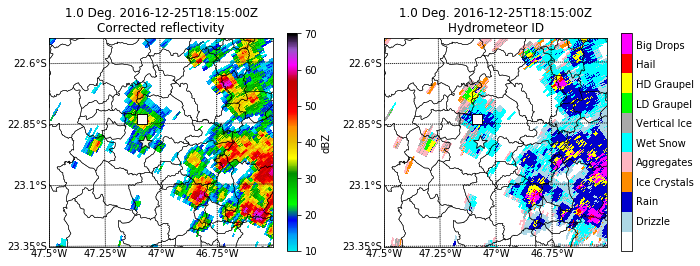

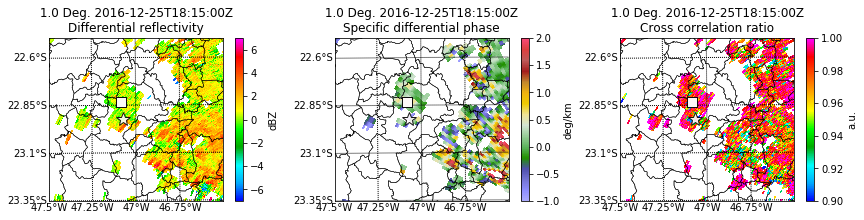

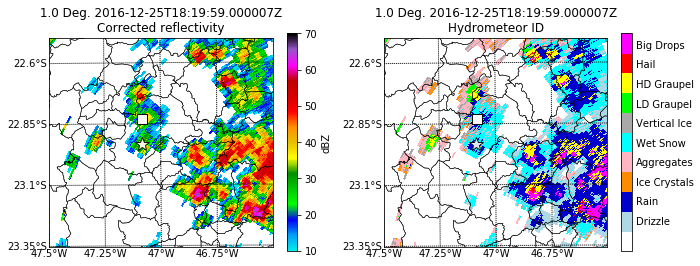

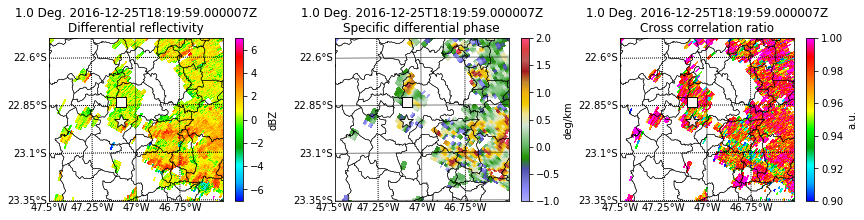

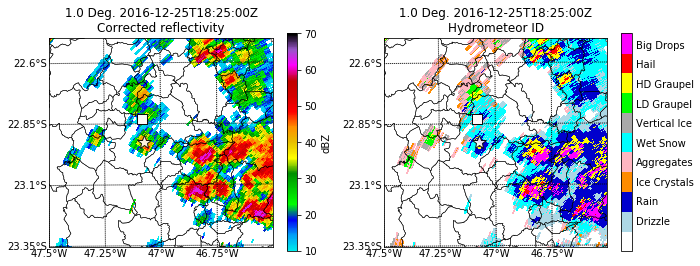

...

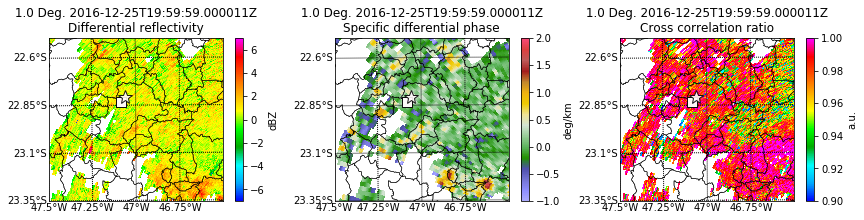

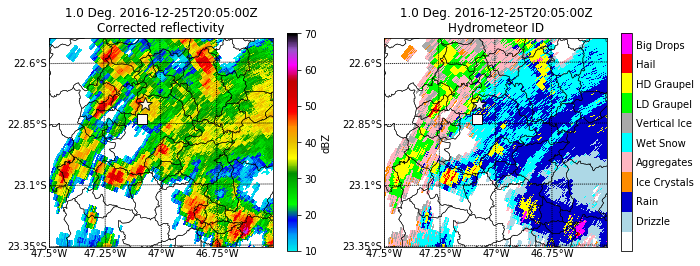

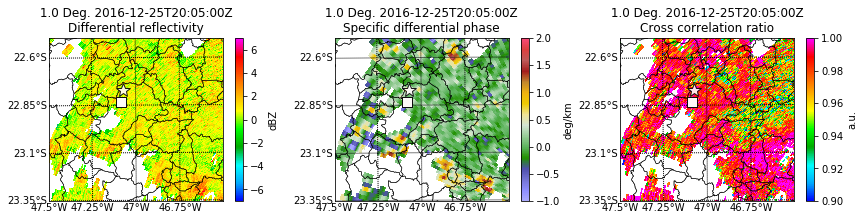

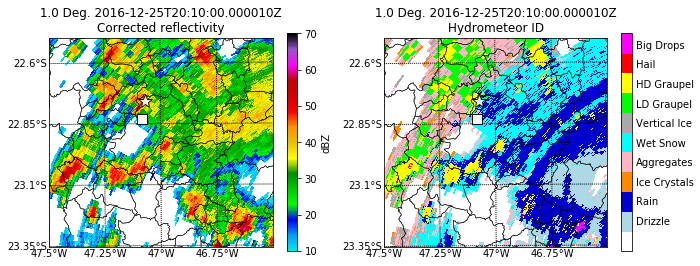

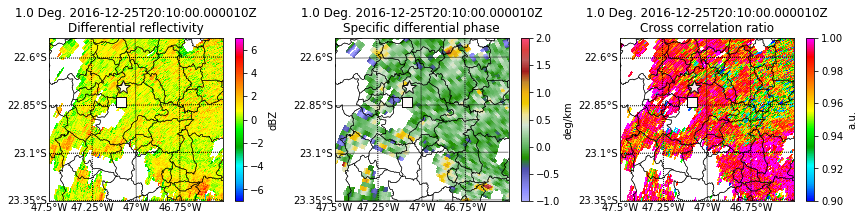

In [21]:
for i in caixas_20161225:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20161225[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20161225, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, 
                                    use_temp = True, T = cthfile_T, band = 'S')
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)
    
    #-- Plotando refletividade + classificação
    centro_sistema = (np.mean(i[2]), np.mean(i[1]))
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[0], centro_sistema, 
                                            var1='corrected_reflectivity', var2='FH', vmin2=0, vmax2=10, 
                                            cmap2=cmaphid, units2='', return_flag=True)
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])
    plt.savefig("figuras/ppis/classificacao/classh_20161225_n"+str(i[0])+'.png', bbox_inches='tight')
    
    #-- Plotando variáveis polarimétricas
    display = pyart.graph.RadarMapDisplay(cthfile)
    fig = plt.figure(figsize = [14.5,3])
    xlim, ylim = [-47.5,-46.5], [-23.35,-22.5]
    
    ax = fig.add_subplot(131)
    display.plot_ppi_map('differential_reflectivity', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -7, vmax = 7, mask_outside = True, colorbar_label = 'dBZ',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[0][0], lon=posicao_hailpads[0][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[0][2], lon=posicao_hailpads[0][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(132)
    display.plot_ppi_map('specific_differential_phase', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -1, vmax = 2, mask_outside = True, colorbar_label = 'deg/km',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[0][0], lon=posicao_hailpads[0][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[0][2], lon=posicao_hailpads[0][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(133)
    display.plot_ppi_map('cross_correlation_ratio', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = 0.9, vmax = 1, mask_outside = True, colorbar_label = 'a.u.',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[0][0], lon=posicao_hailpads[0][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[0][2], lon=posicao_hailpads[0][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    plt.savefig("figuras/ppis/classificacao/polh_20161225_n"+str(i[0])+'.png', bbox_inches='tight')

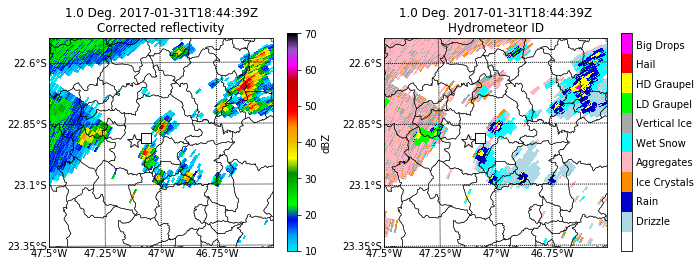

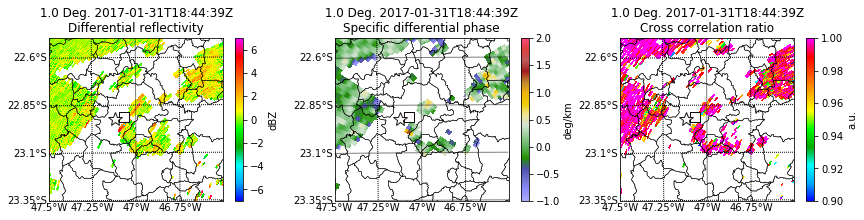

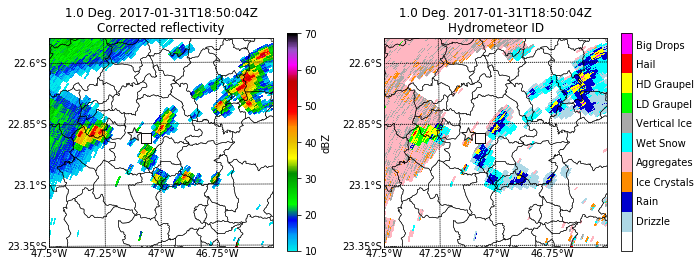

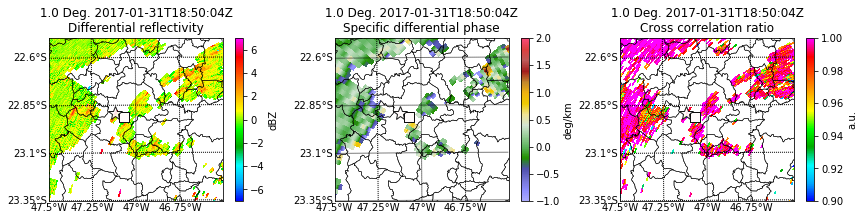

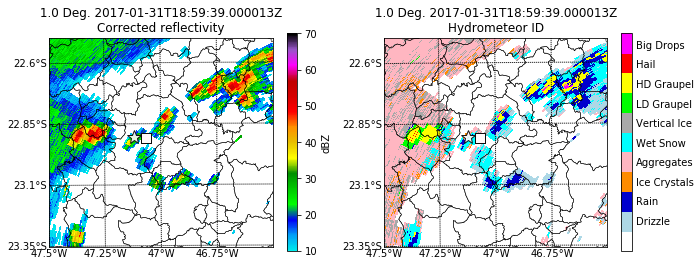

...

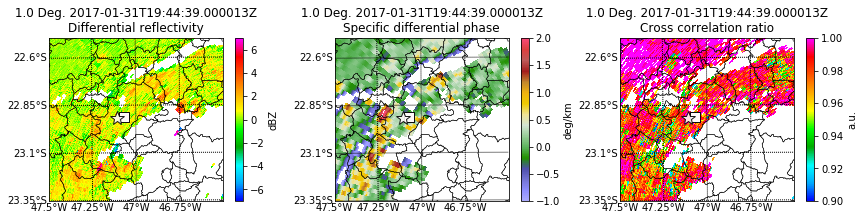

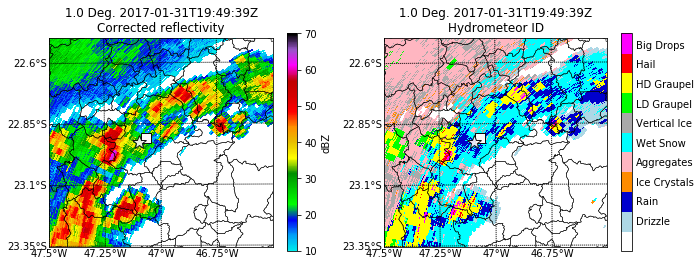

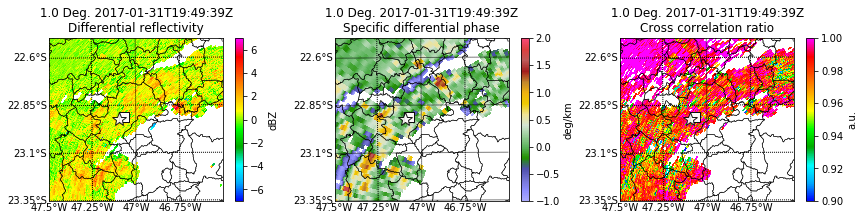

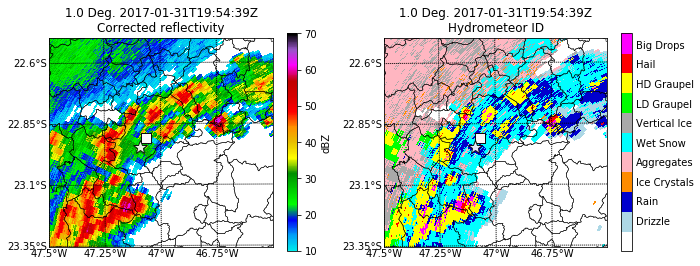

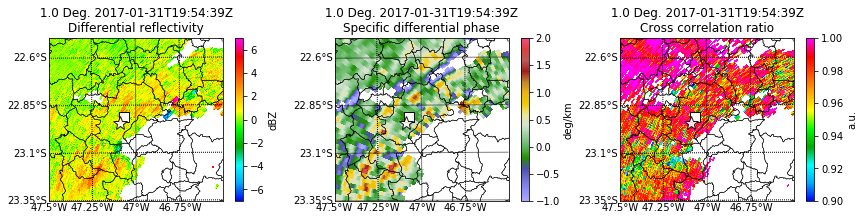

In [20]:
for i in caixas_20170131:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20170131[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20170131, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)
    
    #-- Plotando refletividade + classificação
    centro_sistema = (np.mean(i[2]), np.mean(i[1]))
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[1], centro_sistema, 
                                            var1='corrected_reflectivity', var2='FH', vmin2=0, vmax2=10, 
                                            cmap2=cmaphid, units2='', return_flag=True)
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])
    plt.savefig('figuras/ppis/classificacao/classh_20170131_n'+str(i[0])+'.png', bbox_inches='tight')
        
    #-- Plotando variáveis polarimétricas
    display = pyart.graph.RadarMapDisplay(cthfile)
    fig = plt.figure(figsize = [14.5,3])
    xlim, ylim = [-47.5,-46.5], [-23.35,-22.5]
    
    ax = fig.add_subplot(131)
    display.plot_ppi_map('differential_reflectivity', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -7, vmax = 7, mask_outside = True, colorbar_label = 'dBZ',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[1][0], lon=posicao_hailpads[1][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[1][2], lon=posicao_hailpads[1][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(132)
    display.plot_ppi_map('specific_differential_phase', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -1, vmax = 2, mask_outside = True, colorbar_label = 'deg/km',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[1][0], lon=posicao_hailpads[1][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[1][2], lon=posicao_hailpads[1][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(133)
    display.plot_ppi_map('cross_correlation_ratio', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = 0.9, vmax = 1, mask_outside = True, colorbar_label = 'a.u.',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[1][0], lon=posicao_hailpads[1][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[1][2], lon=posicao_hailpads[1][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    plt.savefig("figuras/ppis/classificacao/polh_20170131_n"+str(i[0])+'.png', bbox_inches='tight')

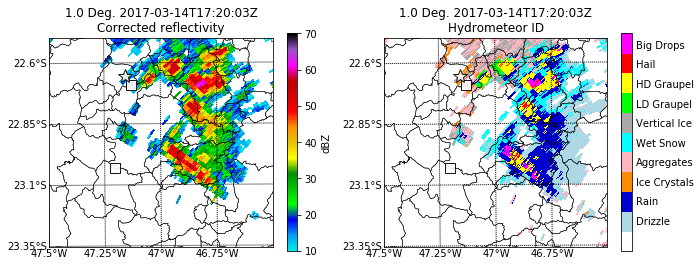

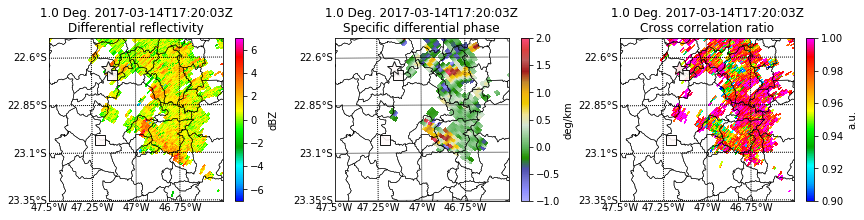

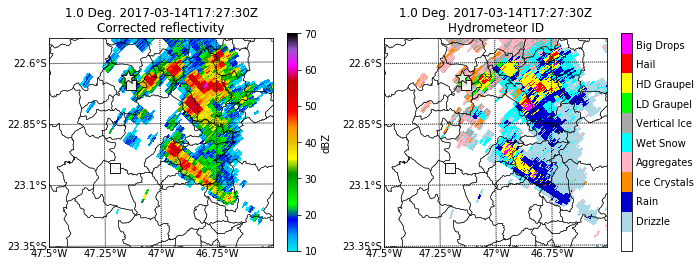

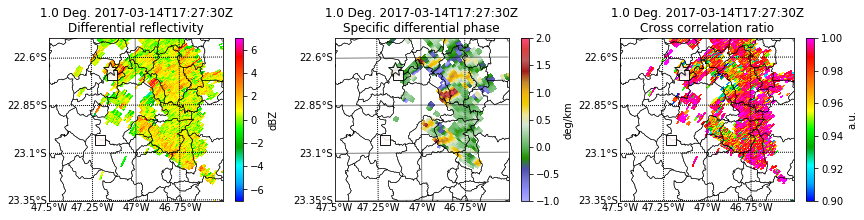

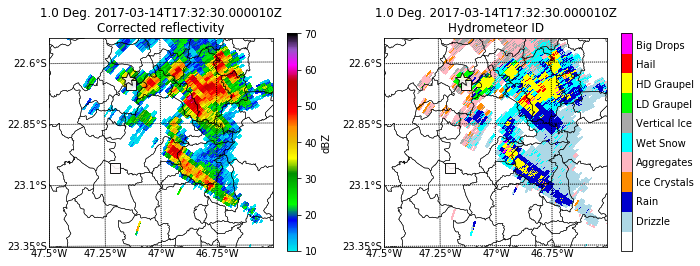

...

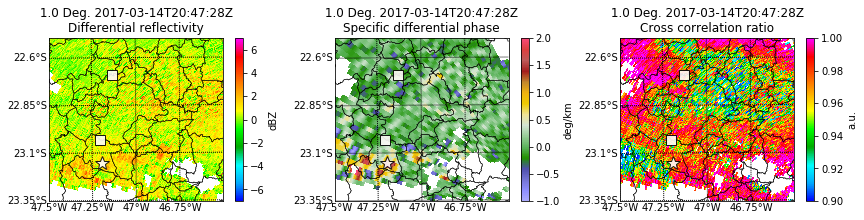

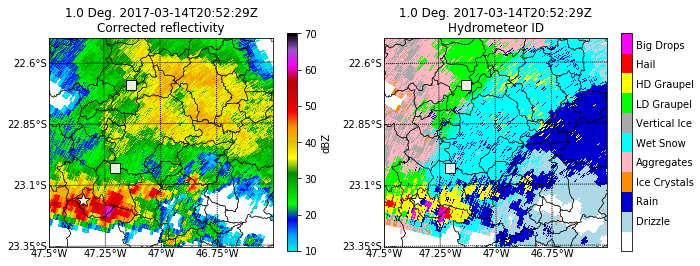

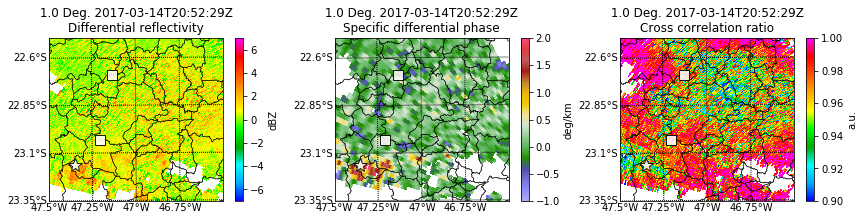

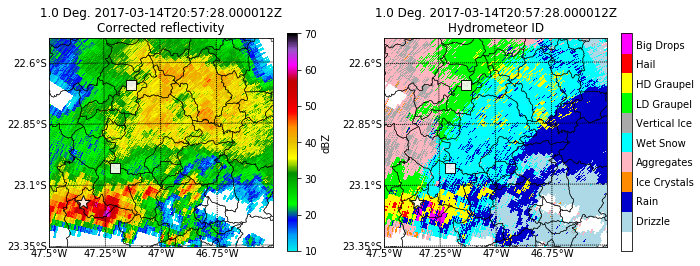

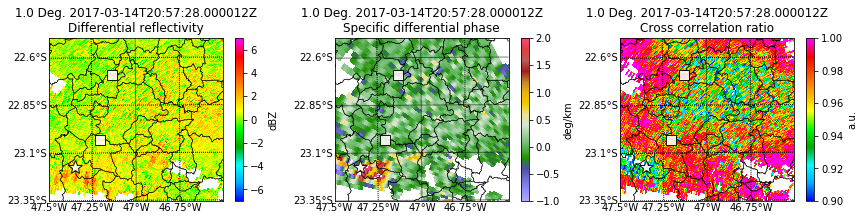

In [17]:
for i in caixas_20170314:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20170314[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20170314, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)
    
    #-- Plotando refletividade + classificação
    centro_sistema = (np.mean(i[2]), np.mean(i[1]))
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[2], centro_sistema, 
                                            var1='corrected_reflectivity', var2='FH', vmin2=0, vmax2=10, 
                                            cmap2=cmaphid, units2='', return_flag=True)
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])  
    plt.savefig('figuras/ppis/classificacao/classh_20170314_n'+str(i[0])+'.png', bbox_inches='tight')
        
    #-- Plotando variáveis polarimétricas
    display = pyart.graph.RadarMapDisplay(cthfile)
    fig = plt.figure(figsize = [14.5,3])
    xlim, ylim = [-47.5,-46.5], [-23.35,-22.5]
    
    ax = fig.add_subplot(131)
    display.plot_ppi_map('differential_reflectivity', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -7, vmax = 7, mask_outside = True, colorbar_label = 'dBZ',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[2][0], lon=posicao_hailpads[2][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[2][2], lon=posicao_hailpads[2][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(132)
    display.plot_ppi_map('specific_differential_phase', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -1, vmax = 2, mask_outside = True, colorbar_label = 'deg/km',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[2][0], lon=posicao_hailpads[2][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[2][2], lon=posicao_hailpads[2][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(133)
    display.plot_ppi_map('cross_correlation_ratio', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = 0.9, vmax = 1, mask_outside = True, colorbar_label = 'a.u.',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[2][0], lon=posicao_hailpads[2][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[2][2], lon=posicao_hailpads[2][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    plt.savefig("figuras/ppis/classificacao/polh_2070314_n"+str(i[0])+'.png', bbox_inches='tight')

/home/ccl/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


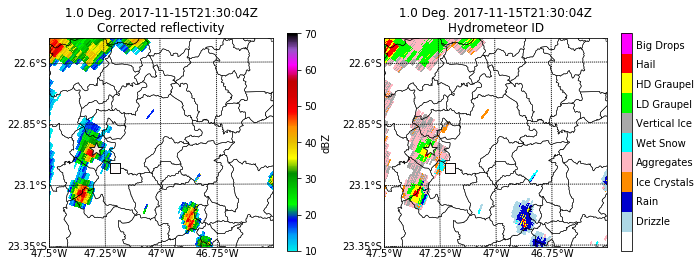

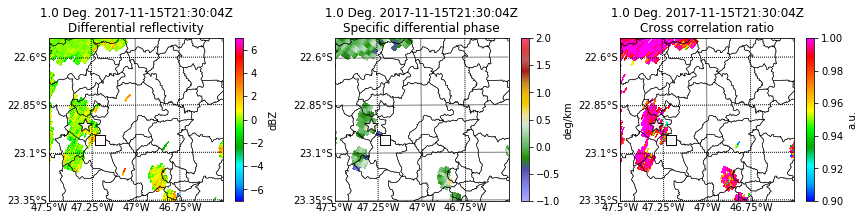

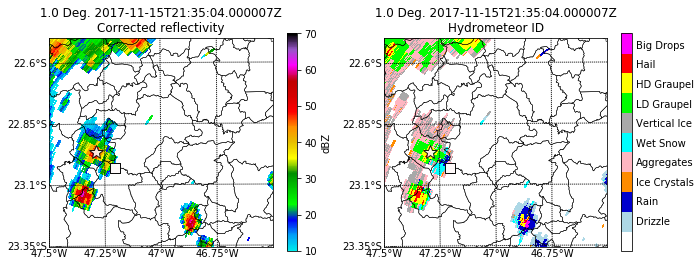

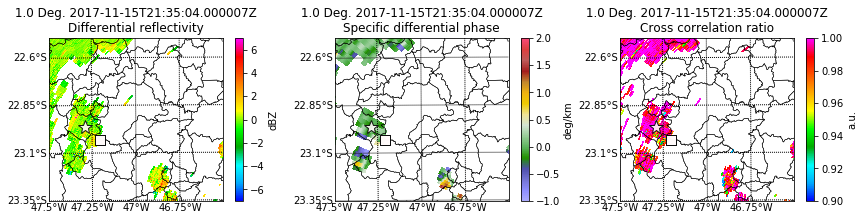

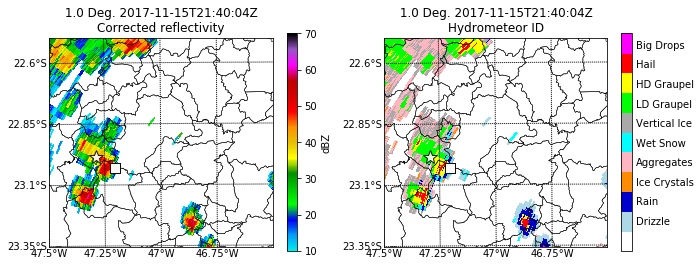

...

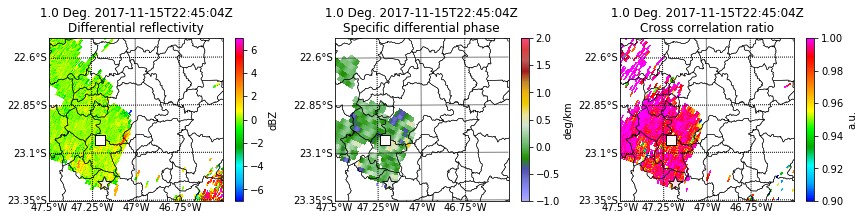

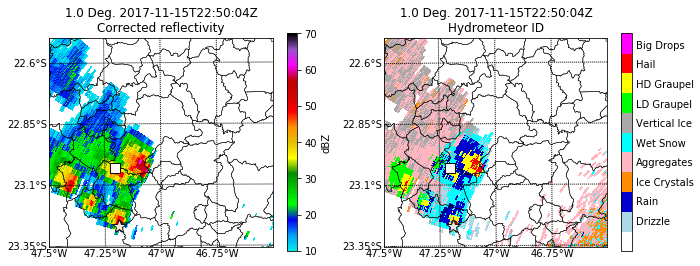

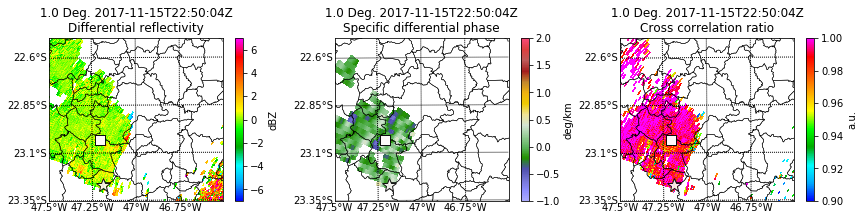

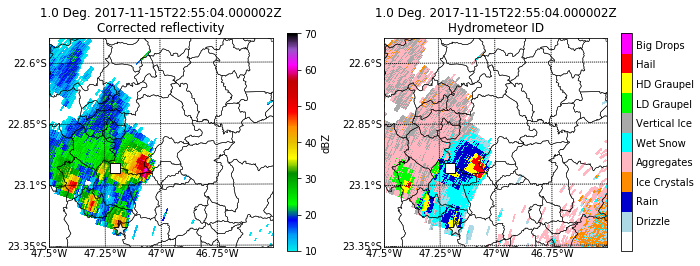

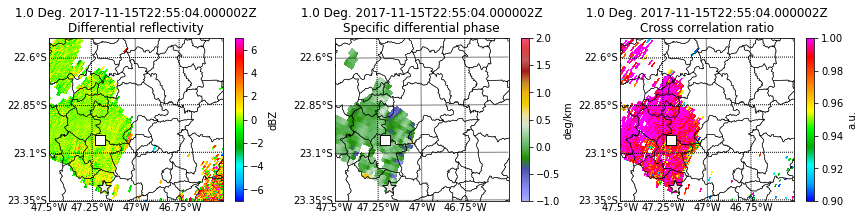

In [12]:
for i in caixas_20171115:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20171115[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20171115, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)
    
    #-- Plotando refletividade + classificação
    centro_sistema = (np.mean(i[2]), np.mean(i[1]))
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[3], centro_sistema, 
                                            var1='corrected_reflectivity', var2='FH', vmin2=0, vmax2=10, 
                                            cmap2=cmaphid, units2='', return_flag=True)
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])    
    plt.savefig('figuras/ppis/classificacao/classh_20171115_n'+str(i[0])+'.png', bbox_inches='tight')
        
    #-- Plotando variáveis polarimétricas
    display = pyart.graph.RadarMapDisplay(cthfile)
    fig = plt.figure(figsize = [14.5,3])
    xlim, ylim = [-47.5,-46.5], [-23.35,-22.5]
    
    ax = fig.add_subplot(131)
    display.plot_ppi_map('differential_reflectivity', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -7, vmax = 7, mask_outside = True, colorbar_label = 'dBZ',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[3][0], lon=posicao_hailpads[3][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[3][2], lon=posicao_hailpads[3][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(132)
    display.plot_ppi_map('specific_differential_phase', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -1, vmax = 2, mask_outside = True, colorbar_label = 'deg/km',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[3][0], lon=posicao_hailpads[3][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[3][2], lon=posicao_hailpads[3][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(133)
    display.plot_ppi_map('cross_correlation_ratio', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = 0.9, vmax = 1, mask_outside = True, colorbar_label = 'a.u.',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[3][0], lon=posicao_hailpads[3][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[3][2], lon=posicao_hailpads[3][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    plt.savefig("figuras/ppis/classificacao/polh_20171115_n"+str(i[0])+'.png', bbox_inches='tight')

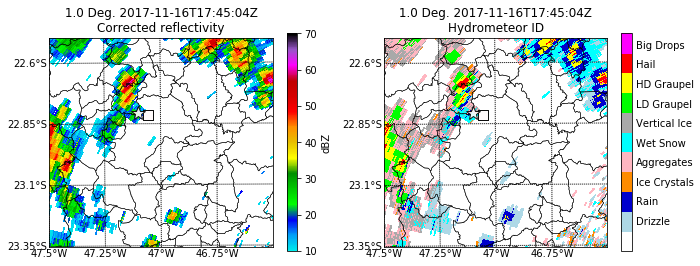

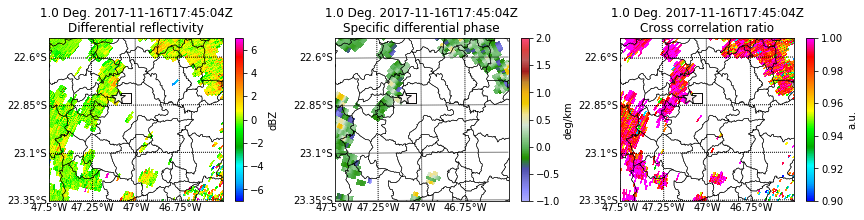

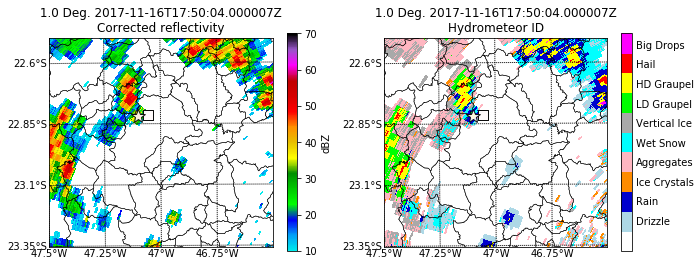

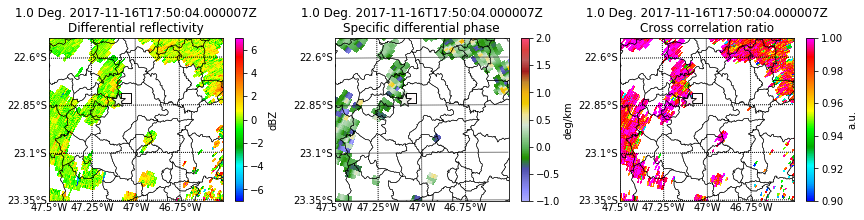

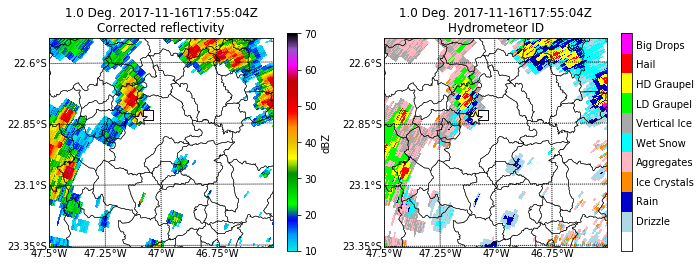

...

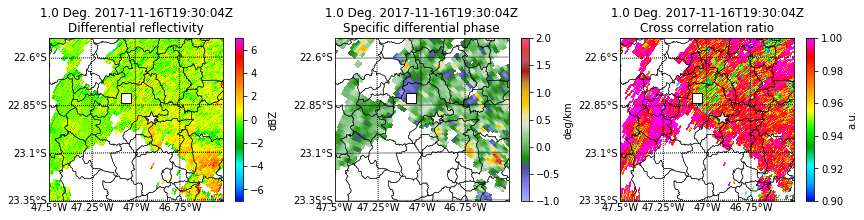

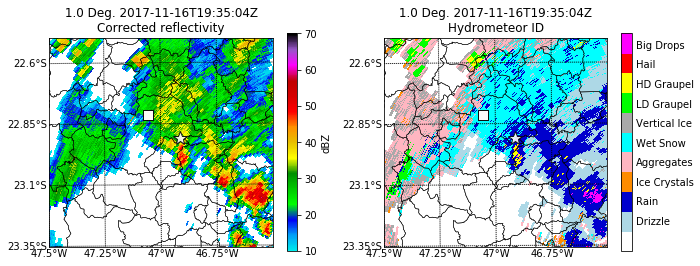

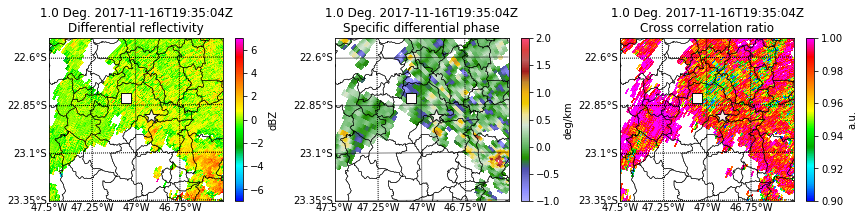

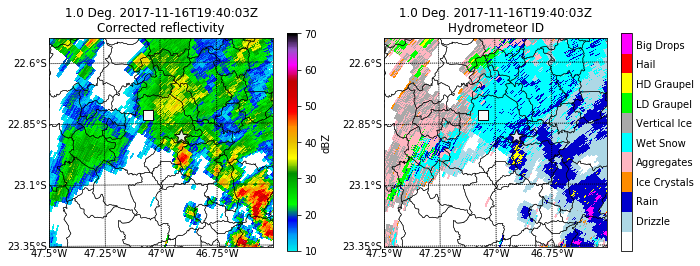

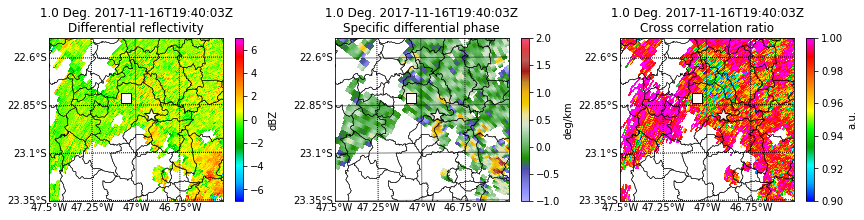

In [19]:
for i in caixas_20171116:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20171116[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20171116, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)
    
    #-- Plotando refletividade + classificação
    centro_sistema = (np.mean(i[2]), np.mean(i[1]))
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[4], centro_sistema, 
                                            var1='corrected_reflectivity', var2='FH', vmin2=0, vmax2=10, 
                                            cmap2=cmaphid, units2='', return_flag=True)
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])
    plt.savefig('figuras/ppis/classificacao/classh_20171116_n'+str(i[0])+'.png', bbox_inches='tight')
        
    #-- Plotando variáveis polarimétricas
    display = pyart.graph.RadarMapDisplay(cthfile)
    fig = plt.figure(figsize = [14.5,3])
    xlim, ylim = [-47.5,-46.5], [-23.35,-22.5]
    
    ax = fig.add_subplot(131)
    display.plot_ppi_map('differential_reflectivity', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -7, vmax = 7, mask_outside = True, colorbar_label = 'dBZ',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[4][0], lon=posicao_hailpads[4][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[4][2], lon=posicao_hailpads[4][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(132)
    display.plot_ppi_map('specific_differential_phase', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = -1, vmax = 2, mask_outside = True, colorbar_label = 'deg/km',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[4][0], lon=posicao_hailpads[4][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[4][2], lon=posicao_hailpads[4][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    ax = fig.add_subplot(133)
    display.plot_ppi_map('cross_correlation_ratio', sweep=0, shapefile="shapefiles/sao_paulo", 
                         max_lat = ylim[1], min_lat = ylim[0], min_lon = xlim[0], max_lon = xlim[1],
                         vmin = 0.9, vmax = 1, mask_outside = True, colorbar_label = 'a.u.',
                         lat_lines = np.arange(ylim[0], ylim[1], .25), lon_lines = np.arange(xlim[0], xlim[1], .25))
    display.plot_point(lat=posicao_hailpads[4][0], lon=posicao_hailpads[4][1], symbol = 'ks', #-- Hailpad 1
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=posicao_hailpads[4][2], lon=posicao_hailpads[4][3], symbol = 'ks', #-- Hailpad 2
                       markersize=10, alpha=0.9, markerfacecolor='snow')
    display.plot_point(lat=centro_sistema[0], lon=centro_sistema[1], symbol = 'k*', #-- Centro da caixa do sistema
                       markersize=15, alpha=0.9, markerfacecolor='snow')
    plt.savefig("figuras/ppis/classificacao/polh_20171116_n"+str(i[0])+'.png', bbox_inches='tight')

### Cortes Verticais no momento em que passou pelo hailpad

In [ ]:
for i in cs_hailpads:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(i[2])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(i[3], cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
     
    #-- Classificando   
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar    
    cthfile = add_field_to_radar_object(fh, cthfile)

    #-- Calculando massas de água líquida e gelo
    mw, mi = csu_liquid_ice_mass.calc_liquid_ice_mass(corr_dBZ, zdr, cthfile_z/1000.0, T=cthfile_T)
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(mw, cthfile, field_name='MW', units='g m-3',
                                        long_name='Liquid Water Mass', standard_name='Liquid Water Mass')
    cthfile = add_field_to_radar_object(mi, cthfile, field_name='MI', units='g m-3',
                                        long_name='Ice Water Mass', standard_name='Ice Water Mass')
    
    #-- Selecionando seção transversal
    cth_cs = pyart.util.cross_section_ppi(cthfile, [i[0]])
    
    #-- Plotando
    display = pyart.graph.RadarDisplay(cth_cs)
   
    #--- Refletividade
    f = plt.figure(figsize = [6,3])
    ax = f.add_subplot(111)
    display.plot('corrected_reflectivity', vmin = 10, vmax = 70, 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nCorrected Reflectivity')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_dBZ_az'+str(i[0])+'.png', bbox_inches='tight')
    
    #--- Classificação
    f = plt.figure(figsize = [6,3])
    ax = f.add_subplot(111)
    display.plot('FH', vmin = 0, vmax = 10, cmap=cmaphid, 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nHydrometeor ID')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])
    plt.savefig('figuras/ppis/classificacao/v_class_az'+str(i[0])+'.png', bbox_inches='tight')
    
    #--- Massa de água
    f = plt.figure(figsize = [6,3])
    ax = f.add_subplot(111)
    display.plot('MW', vmin = 0, vmax = 15, cmap='gnuplot_r', 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nLiquid Water Mass')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_wm_az'+str(i[0])+'.png', bbox_inches='tight')

    #--- Massa de gelo
    f = plt.figure(figsize = [6,3])
    ax = f.add_subplot(111)
    display.plot('MI', vmin = 0, vmax = 15, cmap='gnuplot_r', 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nIce Water Mass')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_im_az'+str(i[0])+'.png', bbox_inches='tight')
    
    #--- ZDR
    f = plt.figure(figsize = [4,3])
    ax = f.add_subplot(111)
    display.plot('differential_reflectivity', vmin = -1, vmax = 3,  
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nDifferential Reflectivity')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_zdr_az'+str(i[0])+'.png', bbox_inches='tight')
    
    #--- FDE
    f = plt.figure(figsize = [4,3])
    ax = f.add_subplot(111)
    display.plot('specific_differential_phase', vmin = -1, vmax = 2, 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nSpecific Differential Phase')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_fde_az'+str(i[0])+'.png', bbox_inches='tight')
    
    #--- RHO
    f = plt.figure(figsize = [4,3])
    ax = f.add_subplot(111)
    display.plot('cross_correlation_ratio', vmin = 0.9, vmax = 1, 
             title = 'Azimuth = '+str(i[0])+' Deg. '+cth_cs.time['units'][14:]+'\nCross Correlation Ratio')
    pnt = ax.scatter(x=i[1], y=1, marker='s', c='snow', alpha=0.9, edgecolors='black') #-- Hailpad
    plt.xlim((130,160))
    plt.ylim((0,18))
    plt.savefig('figuras/ppis/classificacao/v_rho_az'+str(i[0])+'.png', bbox_inches='tight')

---

### BETA: Ciclo de vida de cada tipo de hidrometeoro

In [ ]:
for i in caixas_20161225:
    #-- Lendo os dados, interpolando com a radiossondagem
    cthfile = rbr.read_rainbow_hdf5(files_cth_20161225[i[0]])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20161225, cthfile)
    #-- Extraindo as variáveis necessárias
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    #-- Classificando
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, 
                                    use_temp = True, T = cthfile_T, band = 'S')
    fh = np.argmax(scores, axis = 0) + 1
    #-- Adicionando ao arquivo de radar
    cthfile = add_field_to_radar_object(fh, cthfile)


In [ ]:
cthfile = rbr.read_rainbow_hdf5(files_cth_20161225[caixas_20161225[1][0]])
cthfile_T, cthfile_z = interpolate_sounding_to_radar(snd_20161225, cthfile)
#-- Extraindo as variáveis necessárias
corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
zdr = cthfile.fields['differential_reflectivity']['data']
kdp = cthfile.fields['specific_differential_phase']['data']
rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
#-- Classificando
scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, 
                                    use_temp = True, T = cthfile_T, band = 'S')
fh = np.argmax(scores, axis = 0) + 1
#-- Adicionando ao arquivo de radar
cthfile = add_field_to_radar_object(fh, cthfile)
cthfile_gridded = pyart.map.grid_from_radars((cthfile,), grid_shape=(15, 500, 500), 
                                        grid_limits=((1000,16000),(-200000.,200000.),(-200000.,200000.)))
type(cthfile_gridded)

In [ ]:
coords_lat = cthfile_gridded.point_latitude.values()[2]
coords_lon = cthfile_gridded.point_longitude.values()[2]

type(coords_lat)

In [ ]:
pyart.io.write_grid(filename='/media/camila/CCL_HD/SOS-CHUVA/cth_20161225_n'+str(caixas_20161225[1][0])+'.nc',grid=cthfile_gridded)

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.imshow(cthfile_gridded.fields['FH']['data'][10], origin='lower', cmap=cmaphid)

---

# Testando se usar radiossondagem é melhor ou não

In [ ]:
for i in cs_hailpads:
    cthfile = rbr.read_rainbow_hdf5(i[2])
    cthfile_T, cthfile_z = interpolate_sounding_to_radar(i[3], cthfile)
    
    corr_dBZ = cthfile.fields['corrected_reflectivity']['data']
    zdr = cthfile.fields['differential_reflectivity']['data']
    kdp = cthfile.fields['specific_differential_phase']['data']
    rho_hv = cthfile.fields['cross_correlation_ratio']['data']
    
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = True, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    cthfile = add_field_to_radar_object(fh, cthfile, field_name='FH_ComT', standard_name='Hydrometeor ID with Sonde')
    
    scores = csu_fhc.csu_fhc_summer(dz = corr_dBZ, zdr = zdr, kdp = kdp, rho = rho_hv, use_temp = False, band = 'S',
                                    T = cthfile_T)
    fh = np.argmax(scores, axis = 0) + 1
    cthfile = add_field_to_radar_object(fh, cthfile, field_name='FH_SemT', standard_name='Hydrometeor ID without Sonde')
    
    fig, ax1, ax2, display = two_panel_plot(cthfile, posicao_hailpads[4], centro_sistema, var1='FH_SemT', var2='FH_ComT',
                                            vmax1=10, vmin1=0, vmax2=10, vmin2=0,
                                            cmap1=cmaphid, cmap2=cmaphid, units1='', units2='', return_flag=True)
    display.cbs[0] = adjust_fhc_colorbar_for_pyart(display.cbs[0])        
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])        

    cth_cs = pyart.util.cross_section_ppi(cthfile, [i[0]])

    display = pyart.graph.RadarDisplay(cth_cs)
    
    f = plt.figure(figsize = [13,3])
    
    plt.subplot(1, 2, 2)
    display.plot('FH_ComT', vmin = 0, vmax = 10, cmap=cmaphid)
    plt.xlim((130,160))
    plt.ylim((0,18))
    
    plt.subplot(1, 2, 1)
    display.plot('FH_SemT', vmin = 0, vmax = 10, cmap=cmaphid)
    plt.xlim((130,160))
    plt.ylim((0,18))
    
    display.cbs[0] = adjust_fhc_colorbar_for_pyart(display.cbs[0])
    display.cbs[1] = adjust_fhc_colorbar_for_pyart(display.cbs[1])